In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

manualSeed = 999
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True)

Random Seed:  999


In [ ]:
dataroot = '/content/drive/MyDrive/DL_B3/Dataset'
workers = 2 # Number of workers for dataloader
batch_size = 128 # Batch size during training
image_size = 64 # Set spatial size of training images.
nc = 3 # Number of channels
nz = 100 # Size of z latent vector (i.e. size of generator input)
ngf = 64 # Size of feature maps in generator
ndf = 64 # Size of feature maps in discriminator
num_epochs = 10
lr = 0.0002
beta1 = 0.5 # Beta1 hyperparameter for Adam optimizers
ngpu = 1 # Number of GPUs available. Use 0 for CPU mode.

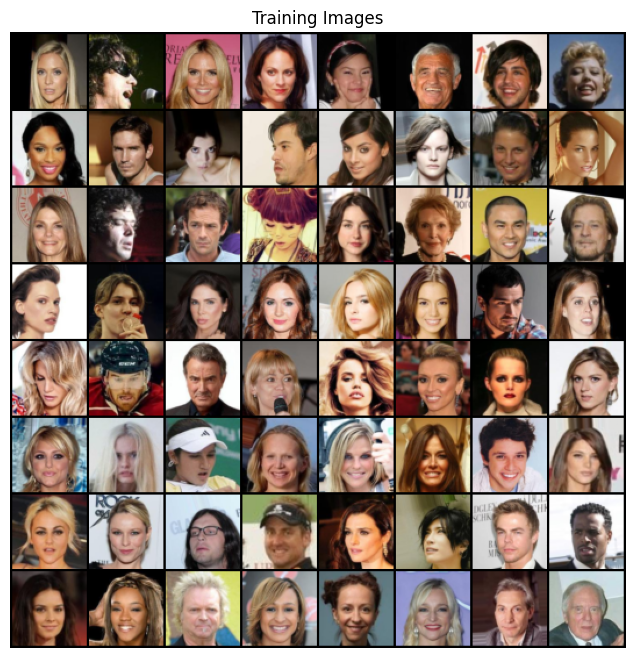

In [ ]:
# Create the dataset (setting up data augmentation)
dataset = dset.ImageFolder(root=dataroot, transform=transforms.Compose([transforms.Resize(image_size), transforms.CenterCrop(image_size), transforms.ToTensor(), transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,shuffle=True, num_workers=workers)
# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [ ]:
print(f"Number of images in dataset: {len(dataset)}")
print(f"Shape of batch: {real_batch[0].shape}")  # (batch_size, channels, height, width)

Number of images in dataset: 4000
Shape of batch: torch.Size([128, 3, 64, 64])


In [ ]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m): # m is a layer in neural network
    classname = m.__class__.__name__ # set m to the name of the layer
    # check layer to create weights
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [ ]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch+1, num_epochs, i+1, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch+1, num_epochs, i+1, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[1/10][1/32]	Loss_D: 0.2687	Loss_G: 23.5467	D(x): 0.9076	D(G(z)): 0.0000 / 0.0000
[1/10][1/32]	Loss_D: 0.2687	Loss_G: 23.5467	D(x): 0.9076	D(G(z)): 0.0000 / 0.0000
[1/10][2/32]	Loss_D: 0.1322	Loss_G: 14.7584	D(x): 0.9529	D(G(z)): 0.0000 / 0.0000
[1/10][3/32]	Loss_D: 0.1116	Loss_G: 5.7505	D(x): 0.9787	D(G(z)): 0.0168 / 0.0096
[1/10][4/32]	Loss_D: 3.0359	Loss_G: 22.7564	D(x): 0.9819	D(G(z)): 0.9092 / 0.0000
[1/10][5/32]	Loss_D: 0.2276	Loss_G: 26.5745	D(x): 0.8992	D(G(z)): 0.0000 / 0.0000
[1/10][6/32]	Loss_D: 0.3075	Loss_G: 25.2745	D(x): 0.8319	D(G(z)): 0.0000 / 0.0000
[1/10][7/32]	Loss_D: 0.1275	Loss_G: 20.4077	D(x): 0.9330	D(G(z)): 0.0000 / 0.0000
[1/10][8/32]	Loss_D: 0.0784	Loss_G: 12.6087	D(x): 0.9539	D(G(z)): 0.0000 / 0.0000
[1/10][9/32]	Loss_D: 0.1679	Loss_G: 5.7596	D(x): 0.9611	D(G(z)): 0.0366 / 0.0093
[1/10][10/32]	Loss_D: 2.6193	Loss_G: 24.1514	D(x): 0.9663	D(G(z)): 0.8837 / 0.0000
[1/10][11/32]	Loss_D: 0.0910	Loss_G: 28.6857	D(x): 0.9421	D(G(z)): 0.0000

In [ ]:
# check weights
print("\nWeights of the Generator:")
for name, param in netG.named_parameters():
    if param.requires_grad:  # Print only trainable parameters
        print(f"{name}:\n{param.data}\n")

print("\nWeights of the Discriminator:")
for name, param in netD.named_parameters():
    if param.requires_grad:  # Print only trainable parameters
        print(f"{name}:\n{param.data}\n")


Weights of the Generator:
main.0.weight:
tensor([[[[ 2.7420e-03,  1.5200e-02,  6.1569e-03, -9.4414e-03],
          [ 5.1446e-02,  2.8560e-03, -3.3582e-02, -2.1526e-02],
          [-2.2451e-02, -1.8398e-02,  2.2185e-02,  2.5317e-02],
          [-6.8405e-04, -1.7463e-02,  2.0261e-02,  7.7654e-04]],

         [[ 1.6784e-02, -5.1691e-03,  2.7353e-02, -2.2197e-02],
          [-8.6715e-03,  1.1357e-03,  1.5362e-02,  1.4128e-02],
          [ 3.6687e-03,  3.7373e-03,  1.0524e-02,  8.0027e-03],
          [-2.8192e-02,  3.0312e-02, -6.3135e-03,  1.2912e-02]],

         [[-9.1680e-03,  1.1504e-02,  2.9363e-02,  6.3355e-03],
          [ 2.1910e-02, -7.7310e-03,  2.8407e-03,  9.3141e-03],
          [-1.0020e-02, -2.9647e-02, -2.5831e-02, -1.8218e-02],
          [ 3.3984e-02, -1.8185e-02,  2.0569e-02, -7.8101e-03]],

         ...,

         [[ 8.3061e-03, -1.9677e-02, -1.1107e-02,  7.8856e-03],
          [-1.7959e-02,  1.4595e-02, -4.1518e-03,  1.6130e-02],
          [ 4.1506e-03, -1.9942e-02,  1.1

In [ ]:
# save model
torch.save({
    'epoch': epoch,
    'generator_state_dict': netG.state_dict(),
    'discriminator_state_dict': netD.state_dict(),
    'optimizerG_state_dict': optimizerG.state_dict(),
    'optimizerD_state_dict': optimizerD.state_dict(),
    'G_losses': G_losses,
    'D_losses': D_losses,
    'img_list': img_list
}, '/content/drive/MyDrive/DL_B3/Save/dcgan_moel.pth')

In [ ]:
# Load the saved model
checkpoint = torch.load('/content/drive/MyDrive/DL_B3/Save/dcgan_moel.pth', weights_only=False)

# Load generator and discriminator models
netG.load_state_dict(checkpoint['generator_state_dict'])
netD.load_state_dict(checkpoint['discriminator_state_dict'])

# Load optimizers (optional if you want to continue training)
optimizerG.load_state_dict(checkpoint['optimizerG_state_dict'])
optimizerD.load_state_dict(checkpoint['optimizerD_state_dict'])

# Load the training losses and generated images if needed
G_losses = checkpoint['G_losses']
D_losses = checkpoint['D_losses']
img_list = checkpoint['img_list']

# Optionally, load the epoch to continue training from where it left off
start_epoch = checkpoint['epoch']


In [ ]:
# continue training
num_additional_epochs = 10
new_epochs = start_epoch + num_additional_epochs
iters = 0

# Training Loop
print("Starting Training Loop...")
for epoch in range(start_epoch, new_epochs):
    for i, data in enumerate(dataloader, 0):
        ############################
        # (1) Update D network
        ############################
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        ############################
        # (2) Update G network
        ############################
        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch+1, new_epochs, i+1, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch+1, new_epochs, i+1, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Optionally save images for visualization
        if (iters % 500 == 0) or ((epoch == new_epochs - 1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[141/150][1/32]	Loss_D: 0.2430	Loss_G: 3.1373	D(x): 0.8789	D(G(z)): 0.1018 / 0.0593
[141/150][1/32]	Loss_D: 0.2430	Loss_G: 3.1373	D(x): 0.8789	D(G(z)): 0.1018 / 0.0593
[141/150][2/32]	Loss_D: 0.2015	Loss_G: 2.9349	D(x): 0.9035	D(G(z)): 0.0881 / 0.0726
[141/150][3/32]	Loss_D: 0.2180	Loss_G: 3.1938	D(x): 0.9062	D(G(z)): 0.1057 / 0.0587
[141/150][4/32]	Loss_D: 0.2738	Loss_G: 2.8752	D(x): 0.8699	D(G(z)): 0.1171 / 0.0741
[141/150][5/32]	Loss_D: 0.2013	Loss_G: 3.0759	D(x): 0.9040	D(G(z)): 0.0874 / 0.0629
[141/150][6/32]	Loss_D: 0.2703	Loss_G: 3.7238	D(x): 0.9156	D(G(z)): 0.1539 / 0.0348
[141/150][7/32]	Loss_D: 0.2083	Loss_G: 2.8688	D(x): 0.8565	D(G(z)): 0.0459 / 0.0806
[141/150][8/32]	Loss_D: 0.2002	Loss_G: 3.2313	D(x): 0.9338	D(G(z)): 0.1158 / 0.0570
[141/150][9/32]	Loss_D: 0.2034	Loss_G: 2.8497	D(x): 0.8867	D(G(z)): 0.0738 / 0.0776
[141/150][10/32]	Loss_D: 0.2063	Loss_G: 2.9449	D(x): 0.9084	D(G(z)): 0.0990 / 0.0672
[141/150][11/32]	Loss_D: 0.2435	Loss_G: 4.0251	D(

In [ ]:
# save and comeback to load the snippet code above
torch.save({
    'epoch': new_epochs,
    'generator_state_dict': netG.state_dict(),
    'discriminator_state_dict': netD.state_dict(),
    'optimizerG_state_dict': optimizerG.state_dict(),
    'optimizerD_state_dict': optimizerD.state_dict(),
    'G_losses': G_losses,
    'D_losses': D_losses,
    'img_list': img_list
}, '/content/drive/MyDrive/DL_B3/Save/dcgan_moel.pth')

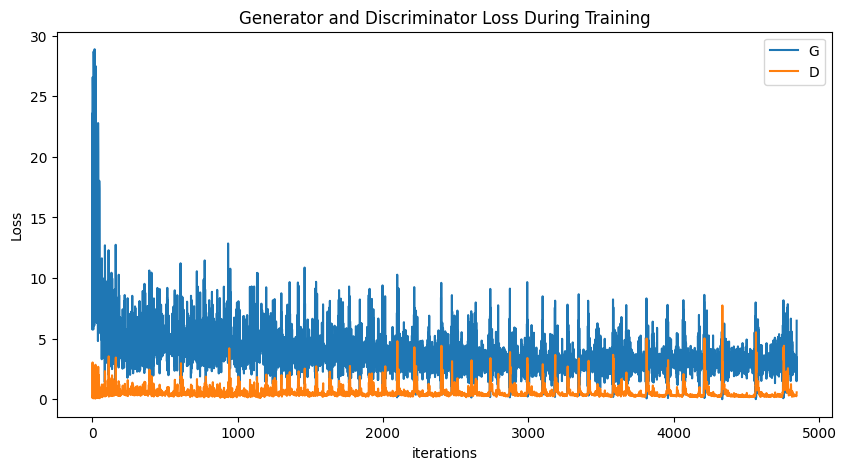

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

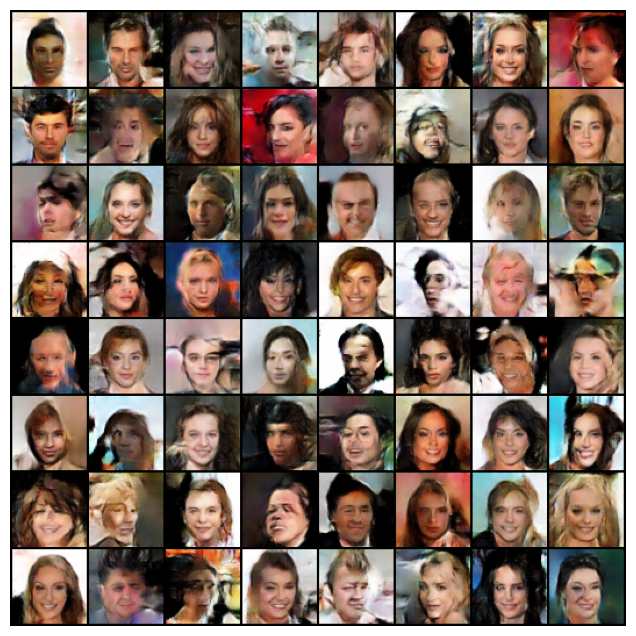

In [ ]:
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 40 * 1024 * 1024
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

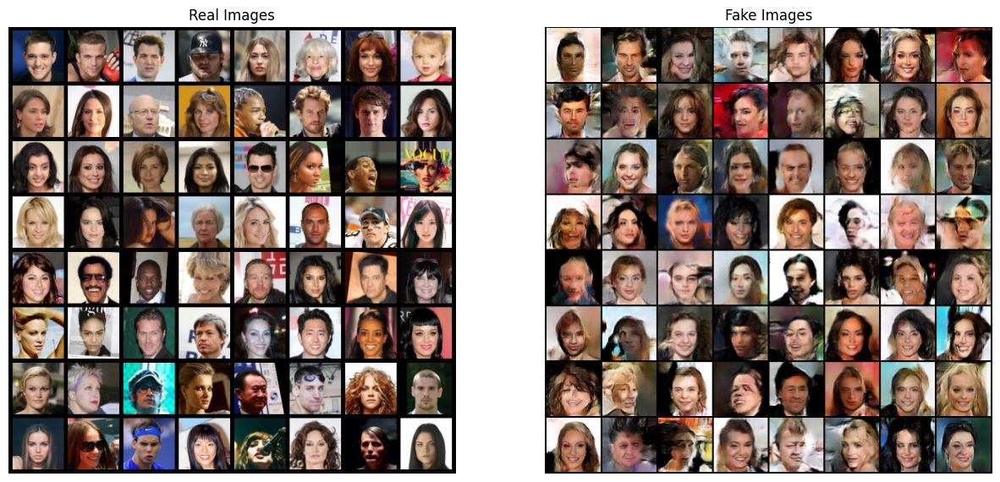

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()